# Варіант 18

## Хід виконання
1. Представити початковi данi графiчно.
2. Побудувати модель кластеризацiї згiдно з варiантом.
3. Виконати кластеризацiю даних на основi моделi.
4. Представити розбиття на кластери графiчно, наприклад, рiзними кольорами.
5. Розрахувати час кластеризацiї. Оцiнити швидкодiю методу на надвеликих наборах даних (наприклад, при збiльшеннi кiлькостi точок даних до мiльйона).
6. Побудувати кiлька альтернативних моделей:
- шляхом змiни значень параметрiв основної моделi,
- використати рiзнi функцiї вiдстанi в алгоритмах, де це можна зробити,
- задати рiзнi значення кiлькостi кластерiв, в алгоритмах де кiлькiсть кластерiв - параметр.
7. Для кожної альтернативної моделi розрахувати метрики якостi кластеризацiї, що реалiзованi в модулi sklearn.metrics (тiльки метрики згiдно з варiантом):
- Estimated Number of Clusters.
- Adjusted Rand Index.
- Adjusted Mutual Information.
- Homogeneity.
- Completeness.
- V-measure.
- Silhouette Coefficient.
- Calinski-Harabasz Index.
- Davies-Bouldin index.
- Contingency Matrix.
8. Виконати аналiз результатiв кластеризацiї одним з неформальних методiв (тiльки методом згiдно з варiантом):
- чи є розбиття стабiльним на пiдвибiрках даних,
- чи є розбиття стабiльним пiсля видалення окремих об’єктiв,
- чи є розбиття стабiльним пiсля змiни порядку об’єктiв у множинi об’єктiв,
- чи iснує взаємозв’язок мiж результатами кластеризацiї i змiнними, якi не враховувалися при кластеризацiї,
- чи можна iнтерпретувати результати кластеризацiї.
9. Зробити висновки про якiсть роботи моделей на дослiджених даних та про швидкодiю методу.
10. Оцiнити результати кластеризацiї на основi метрик якостi та на основi неформальних методiв. У кожному варiантi задано два набори даних. Спробувати пiдiбрати найкращу модель кластеризацiї для кожного набору даних.

## Завдання

Алгоритм k-середнiх, використати cluster.KMeans i cluster.MiniBatchKMeans.
Вiдобразити графiчно центри кластерiв.

Метрики якостi: Adjusted Rand Index, Calinski-Harabasz Index, Davies-
Bouldin index.

Чи є розбиття стабiльним на пiдвибiрках даних?

In [2]:
# код для центрування графіків
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

## Завдання 1

In [3]:
from sklearn.datasets import make_blobs

n_samples_1 = 1000
n_samples_2 = 700

centers = [[0.0, 0.0] , [-3.5, -3.5]]
clusters_std = [2.0, 1.0]

X, y = make_blobs (n_samples=[n_samples_1 , n_samples_2],
                   centers = centers,
                   cluster_std = clusters_std,
                   random_state = 0, shuffle = False)

## 1.1 Візуалізація

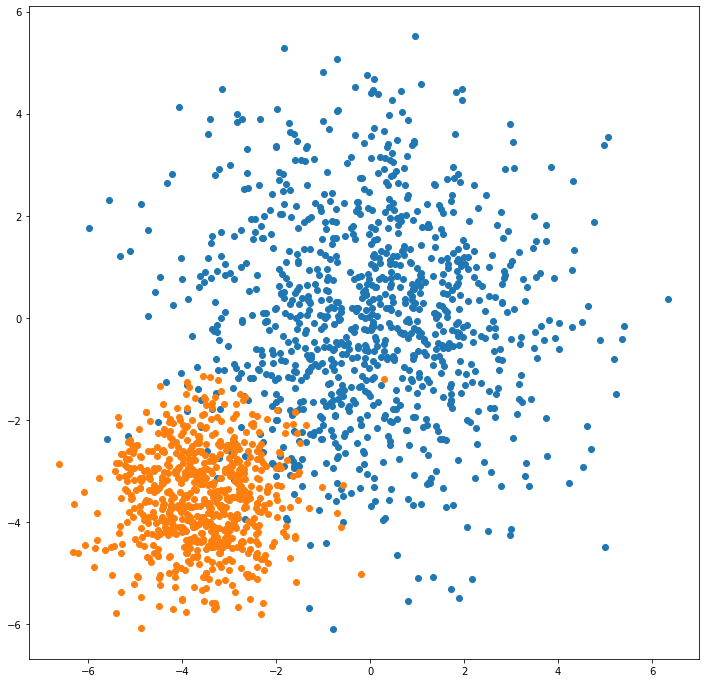

In [4]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 12))

plt.scatter(X[:1000, 0], X[:1000, 1]);
plt.scatter(X[1000:, 0], X[1000:, 1]);

## 1.2 Побудова моделей та кластеризація

In [5]:
from sklearn.cluster import KMeans, MiniBatchKMeans

KMean = KMeans(n_clusters = 2, random_state = 42).fit(X)
miniKMean = MiniBatchKMeans(n_clusters = 2, random_state = 42).fit(X)

## 1.3 Результати кластеризації графічно

Спочатку зобразимо результат кластеризації для моделі KMeans

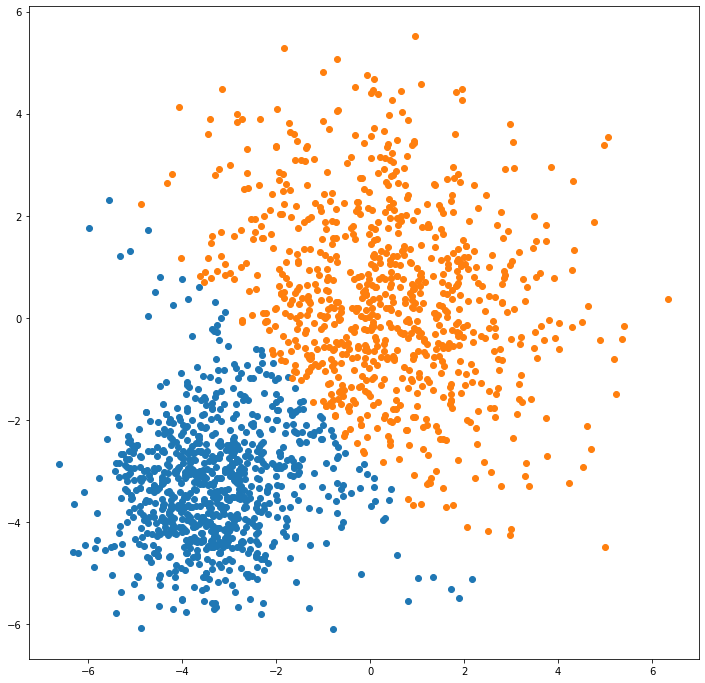

In [6]:
import numpy as np

predictions = KMean.predict(X)
first_class_ind = np.where(predictions == 0.0)
second_class_ind = np.where(predictions == 1.0)

plt.figure(figsize=(12, 12))
plt.scatter(X[first_class_ind, 0], X[first_class_ind, 1]);
plt.scatter(X[second_class_ind, 0], X[second_class_ind, 1]);

Тепер зобразимо результат кластеризації для моделі MiniBatchKMeans 

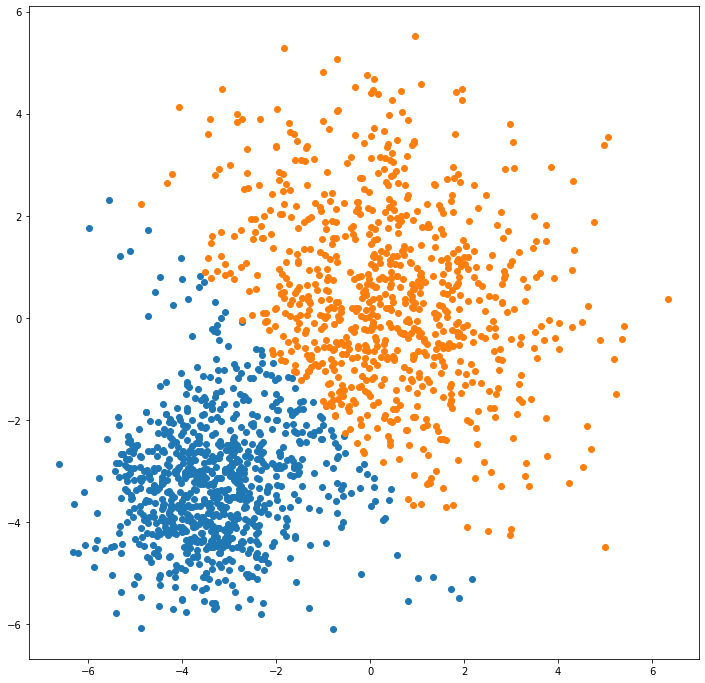

In [7]:
predictions = miniKMean.predict(X)
first_class_ind = np.where(predictions == 0.0)
second_class_ind = np.where(predictions == 1.0)

plt.figure(figsize=(12, 12))
plt.scatter(X[first_class_ind, 0], X[first_class_ind, 1]);
plt.scatter(X[second_class_ind, 0], X[second_class_ind, 1]);

Як бачимо, дуже схожий на попередній графік

## 1.4 час кластеризації

Розрахуємо час кластеризації для таких величин наборів даних:

- перший кластер - 10000, другий - 7000
- перший кластер - 100000, другий - 70000
- перший кластер - 1000000 другий - 700000

Спочатку порівняємо час кластеризування для моделі KMeans 

In [8]:
# створення кластерів
first = [10000, 100000, 1000000]
second = [7000, 70000, 700000]
centers = [[0.0, 0.0] , [-3.5, -3.5]]
clusters_std = [2.0, 1.0]

X_time = {}
y_time = {}

for ind in range(3):
    
    label = str(first[ind]) + ", " + str(second[ind])
    
    X_time[label], y_time[label] = make_blobs (n_samples=[first[ind] , second[ind]],
                                               centers = centers,
                                               cluster_std = clusters_std,
                                               random_state = 0, shuffle = False)


In [9]:
import time 

def time_calculation(model, X : dict):
    
    # обчислення часу
    elapsed_time = []
    labels = list(X.keys())

    for i in range(3):
    
        start = time.time()
        model = KMeans(n_clusters = 2).fit(X[labels[i]])
        end = time.time()
        elapsed_time.append(end - start)

    # вивід результату
    for i in range(3):
        n_spaces = 20 - len(str(labels[i]))
        print(str(labels[i]) + n_spaces*" " + str(round(elapsed_time[i], 5)))
    
time_calculation(KMeans(n_clusters = 2, random_state = 42), X_time)

10000, 7000         0.08153
100000, 70000       0.48004
1000000, 700000     3.8934


Тепер порівняємо час кластеризування для моделі MiniBatchKMeans

In [10]:
time_calculation(MiniBatchKMeans(n_clusters = 2, random_state = 42), X_time)

10000, 7000         0.07
100000, 70000       0.42754
1000000, 700000     4.24351


Як бачимо обидві моделі кластеризують дані приблизно за один і той же час

## 1.5 Альтернативні моделі для KMeans

Побудуємо такі альтернативні моделі:

- KMeans(n_clusters = 2, random_state = 30)
- KMeans(n_clusters = 2, random_state = 42, algorithm = "elkan")
- KMeans(n_clusters = 2, random_state = 42, tol = 1e-3)
- KMeans(n_clusters = 4, random_state = 42)

KMeans(n_clusters=2, random_state=30):


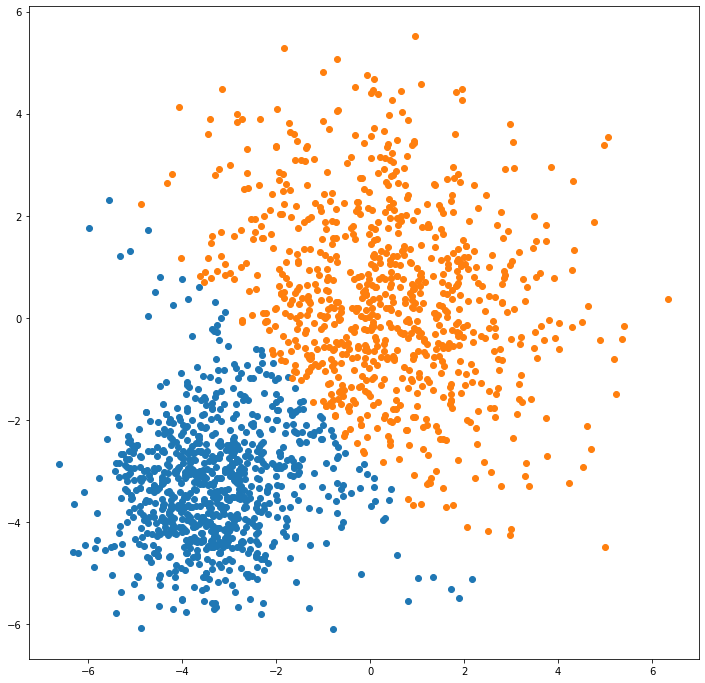

KMeans(algorithm='elkan', n_clusters=2, random_state=42):


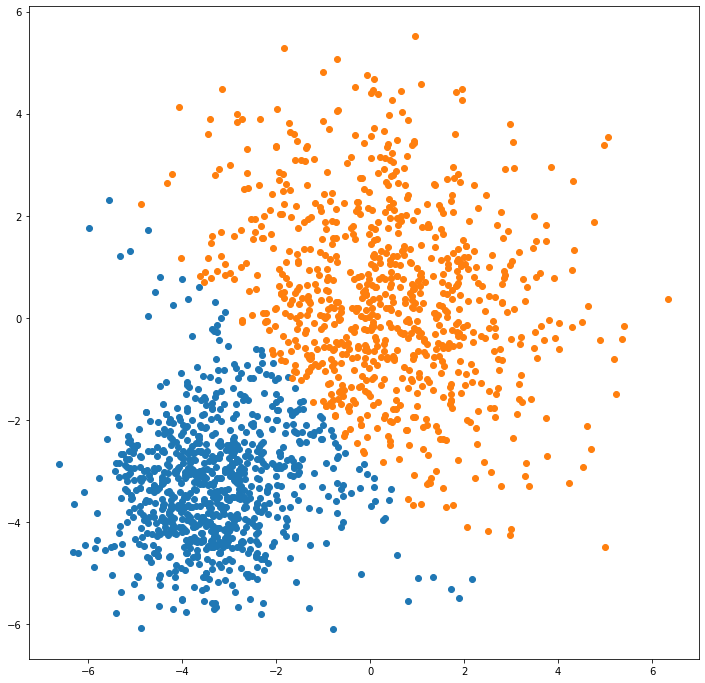

KMeans(n_clusters=2, random_state=42, tol=0.001):


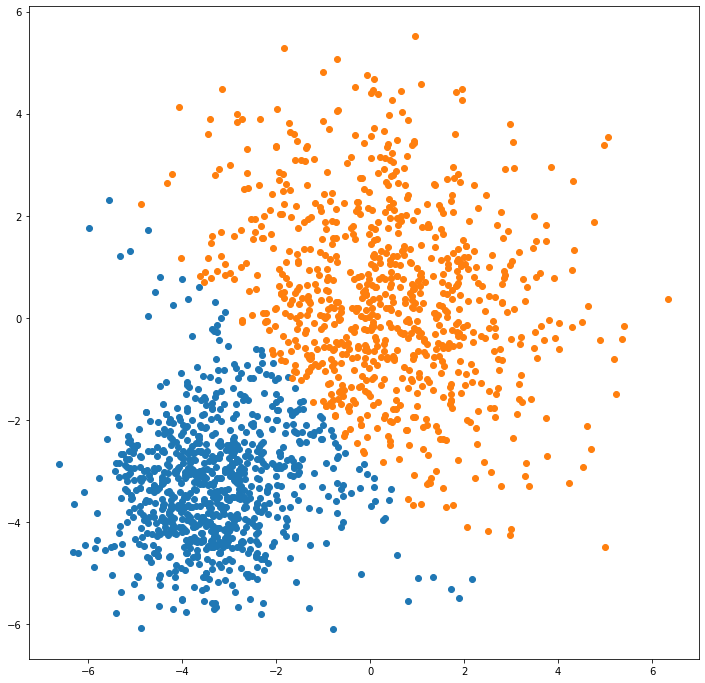

KMeans(n_clusters=4, random_state=42):


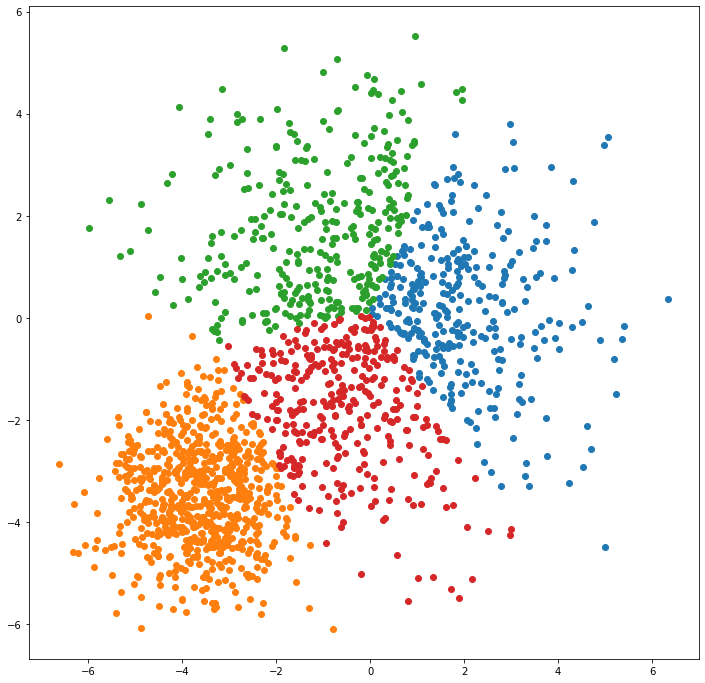

In [11]:
kmean_models = [KMeans(n_clusters = 2, random_state = 30),
                KMeans(n_clusters = 2, random_state = 42, algorithm = "elkan"),
                KMeans(n_clusters = 2, random_state = 42, tol = 1e-3),
                KMeans(n_clusters = 4, random_state = 42)
]

# функцція для візуалізації кластерів

def cluster_visualisation(models, data, labels = None, second_task = False):
    
    models_list = []
    if type(models) == dict:
        for model in list(models,keys()):
            models_list.append(model)
    else:
        models_list = models.copy()
    
    step = 0
    for model in models_list:
    
        
        model.fit(data)
        predictions = model.predict(data)
   
        clusters = []
        n_clusters = model.get_params()['n_clusters'] 
    
        # виділяємо індекси окремих кластерів
        for cluster_number in range(n_clusters):
            clusters.append(np.where(predictions == cluster_number))

        # візуалізовуємо кластери
        if not labels:
            print(str(model) + ":")
        else:
            print(labels[step])
            step += 1
        
        
        if second_task:
            plt.figure(figsize=(100, 100))
            plt.xlim([-10, 10])
            plt.ylim([-10, 10])
        else:
            plt.figure(figsize=(12, 12))
        
        for cluster in clusters:
            plt.scatter(data[cluster, 0], data[cluster, 1]);
    
        plt.show() 
    
cluster_visualisation(kmean_models, X)

Тепер порахуємо метрики, які зазначені в завданні, а саме - Adjusted Rand Index, Calinski-Harabasz Index, Davies-Bouldin index

In [12]:
from sklearn.metrics import adjusted_rand_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.base import clone

def print_metrics(models:list, X, sub_y = None, labels = None, y_true = y):
    
    if type(X) == dict:
    
        fitting_time = {}
        adj_score = {}
        calinski_score = {}
        davies_score = {}
        model_names = []
        
        for model in models:
            model_name = str(model)
            model_names.append(model_name)

            # тут будуть назви метрик
            fitting_time["metric_name"] = "fitting time"
            adj_score["metric_name"] = "Adjusted Rand Index"
            calinski_score["metric_name"] = "Calinski-Harabasz Index"
            davies_score["metric_name"] = "Davies-Bouldin index"
            
            # тут будуть значення метрик
            fitting_time[model_name] = []
            adj_score[model_name] = []
            calinski_score[model_name] = []
            davies_score[model_name] = []
            
            
            # cтворюємо словники зі значеннями метрик, а також словник з часов навчання моделі
            for X_key in list(X.keys()):
                
                non_fitted_model = clone(model)
                
                start = time.time()
                non_fitted_model.fit(X[X_key])
                end = time.time()
                predictions = non_fitted_model.predict(X[X_key])
                
                y_ = sub_y[X_key] 
                fitting_time[model_name].append(end - start)
                adj_score[model_name].append(adjusted_rand_score(y_, predictions))
                calinski_score[model_name].append(calinski_harabasz_score(X[X_key], predictions))
                davies_score[model_name].append(davies_bouldin_score(X[X_key], predictions))

            # візуалізовуємо значення            
            metrics = [adj_score, calinski_score, davies_score, fitting_time]
            
            print("                       ", *labels, sep = "      ")
            for metric in metrics:
                print(metric["metric_name"], ":", end = (26-len(metric["metric_name"]))*" ")
                
                if metric["metric_name"] == "Calinski-Harabasz Index":
                    print(*[round(value, 1) for value in metric[model_name]], sep = "   ")
                else:
                    print(*[round(value, 4) for value in metric[model_name]], sep = "   ")
                
        
    else:
        
        for model in models:
            
            start = time.time()
            model.fit(X)
            end = time.time()
            predictions = model.predict(X)
            
            adj_score = adjusted_rand_score(y_true, predictions)
            calinski_score = calinski_harabasz_score(X, predictions)
            davies_score =  davies_bouldin_score(X, predictions)
            
            print(str(model))
            n_spaces = 5
            print("Adjusted Rand Index:    " + n_spaces*" " + str(round(adj_score, 4)))
            print("Calinski-Harabasz Index:" + n_spaces*" " + str(round(calinski_score, 4)))
            print("Davies-Bouldin index:   " + n_spaces*" " + str(round(davies_score, 4)))
            print("fitting time:           " + n_spaces*" " + str(round(end - start, 4)))
            print("\n")

In [13]:
print_metrics(kmean_models, X)

KMeans(n_clusters=2, random_state=30)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.062


KMeans(algorithm='elkan', n_clusters=2, random_state=42)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.055


KMeans(n_clusters=2, random_state=42, tol=0.001)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.052


KMeans(n_clusters=4, random_state=42)
Adjusted Rand Index:         0.4466
Calinski-Harabasz Index:     1864.922
Davies-Bouldin index:        0.885
fitting time:                0.11




Як бачимо перші три моделі дали однакові значення метрик, але швидше навчилась модель з параметрами n_clusters=2, random_state=42, tol=0.001. Четверта модель дає найгірші значення метрик, а також найбільший час навчання.

## 1.6 Альтернативні моделі для MiniBatchKMeans

Побудуємо такі альтернативні моделі:
- MiniBatchKMeans(n_clusters = 8, random_state = 30)
- MiniBatchKMeans(n_clusters = 2, random_state = 42)
- MiniBatchKMeans(n_clusters = 2, random_state = 30, reassignment_ratio = 0.01)
- MiniBatchKMeans(n_clusters = 2, random_state = 42, n_init = 5)

MiniBatchKMeans(n_clusters=2, random_state=42):


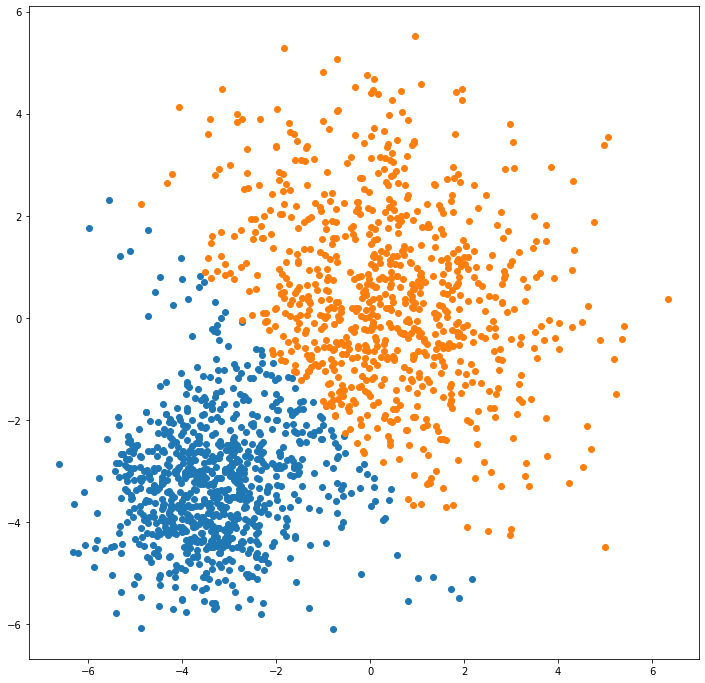

MiniBatchKMeans(n_clusters=2, random_state=30):


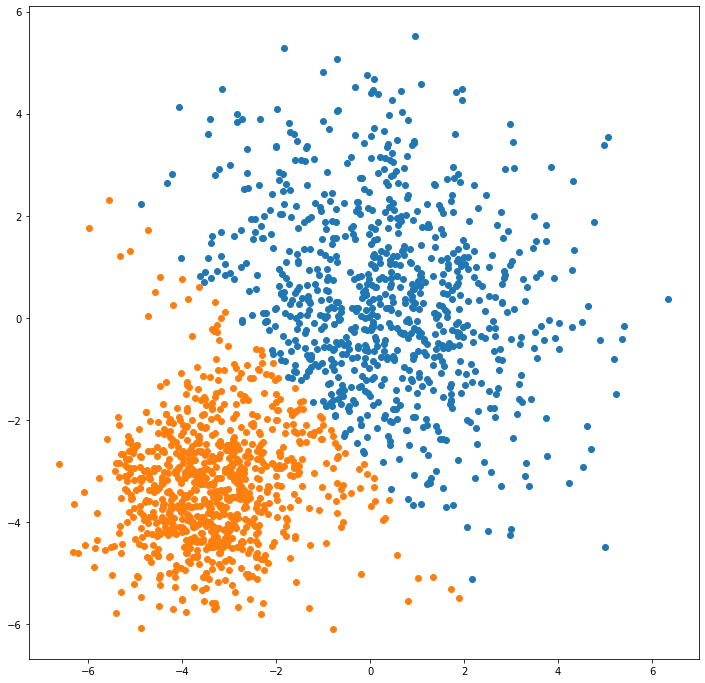

MiniBatchKMeans(n_clusters=2, n_init=5, random_state=42):


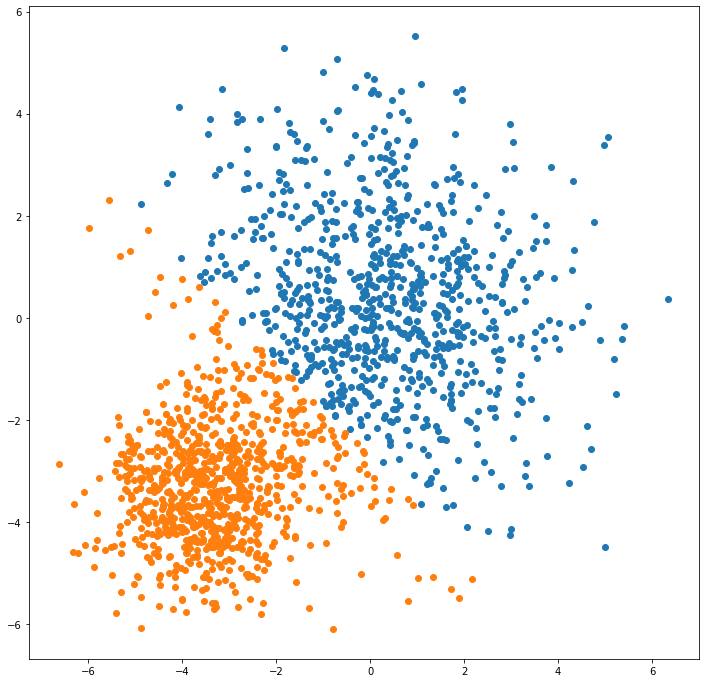

MiniBatchKMeans(random_state=30):


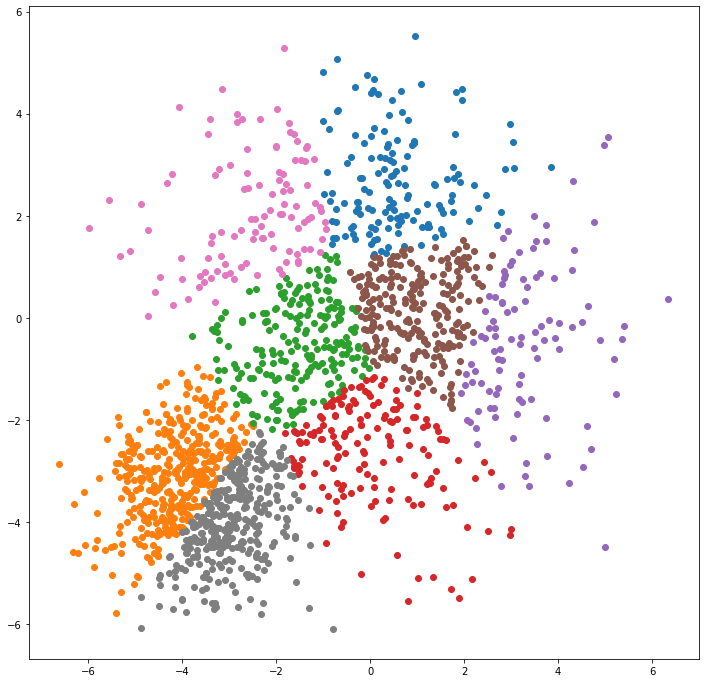

In [14]:
minikmean_models = [MiniBatchKMeans(n_clusters = 2, random_state = 42),
                    MiniBatchKMeans(n_clusters = 2, random_state = 30, reassignment_ratio = 0.01),
                    MiniBatchKMeans(n_clusters = 2, random_state = 42, n_init = 5),
                    MiniBatchKMeans(n_clusters = 8, random_state = 30)
                   ]

cluster_visualisation(minikmean_models, X)

Тепер порахуємо метрики

In [15]:
print_metrics(minikmean_models, X)

MiniBatchKMeans(n_clusters=2, random_state=42)
Adjusted Rand Index:         0.6267
Calinski-Harabasz Index:     2457.9011
Davies-Bouldin index:        0.7202
fitting time:                0.055


MiniBatchKMeans(n_clusters=2, random_state=30)
Adjusted Rand Index:         0.6455
Calinski-Harabasz Index:     2458.2925
Davies-Bouldin index:        0.7183
fitting time:                0.086


MiniBatchKMeans(n_clusters=2, n_init=5, random_state=42)
Adjusted Rand Index:         0.6229
Calinski-Harabasz Index:     2456.0491
Davies-Bouldin index:        0.7209
fitting time:                0.055


MiniBatchKMeans(random_state=30)
Adjusted Rand Index:         0.2337
Calinski-Harabasz Index:     1547.6809
Davies-Bouldin index:        1.0003
fitting time:                0.084




Остання модель,  у якої кількість кластерів дорівнює 8 дала найгірші значення метрик. Найкращі результати показала модель з параметрами n_clusters=2, random_state=30, у якої найкращі значення всіх метрик

## 1.7 Перевірка результатів кластеризації одним з неформальних способів

У моєму варіанті неформальним способом є перевірка стабільності розбиття на підвибірках даних. Спочатку перемішаємо наші дані, а потім виділимо підвибірки такого розміру: 20%, 40%, 60% і перевіримо якість кластеризації графічно, а також за допомогою метрик

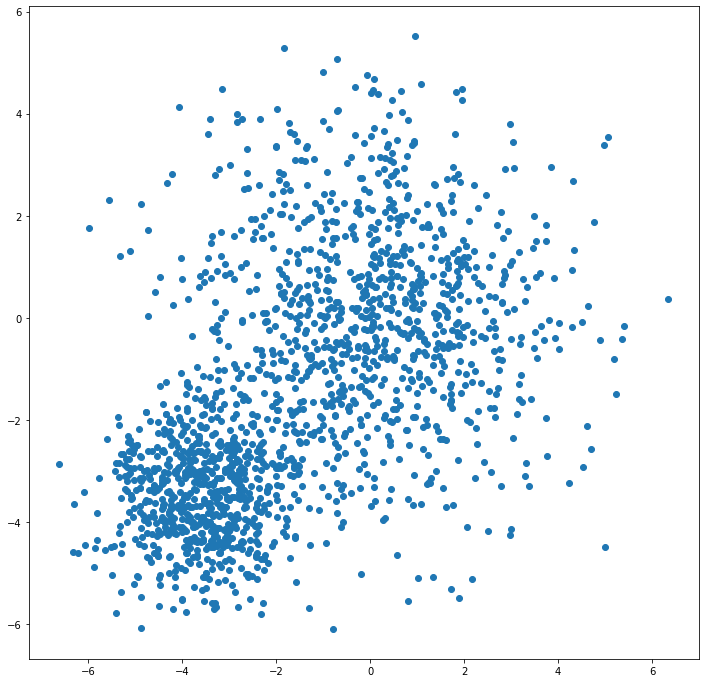

In [16]:
from numpy.random import shuffle

data = np.concatenate((X, y[:, np.newaxis]), axis = 1)
shuffle(data)

X_shuffled = data[:, :2]
y_shuffled = data[:,  2]

#перевіримо чи не змінилась візуалізція даних
plt.figure(figsize=(12, 12))
plt.scatter(X_shuffled[:, 0], X_shuffled[:, 1]);

In [17]:
# створимо підбірки даних
percentages = [0.2, 0.4, 0.6]
subarrays = {}
sub_ytrue = {}

for percentage in percentages:
    
    subarr_len = int(len(X)*percentage)
    subarrays[int(percentage*100)] = X_shuffled[:subarr_len]
    sub_ytrue[int(percentage*100)] = y_shuffled[:subarr_len]
    
    # перевірка коректонсті розбиття
    print(f"{percentage *100}% -> {len(subarrays[percentage*100])}")


20.0% -> 340
40.0% -> 680
60.0% -> 1020


In [18]:
# тепер навчимо моделі 
model_sub = {"kmean": {}, "mini_kmean":{}}
percentages = list(subarrays.keys())

for percentage in percentages:
    
    model_sub["kmean"][percentage] = KMeans(n_clusters = 2, random_state = 30).fit(subarrays[percentage])
    model_sub["mini_kmean"][percentage] = MiniBatchKMeans(n_clusters = 2, random_state = 30).fit(subarrays[percentage])
        
    

### 1.7.1 KMeans

Почнемо з моделі KMeans. Спочатку побудуємо графіки кластерів, а потім покажемо значення метрик.

20% від початкових даних:


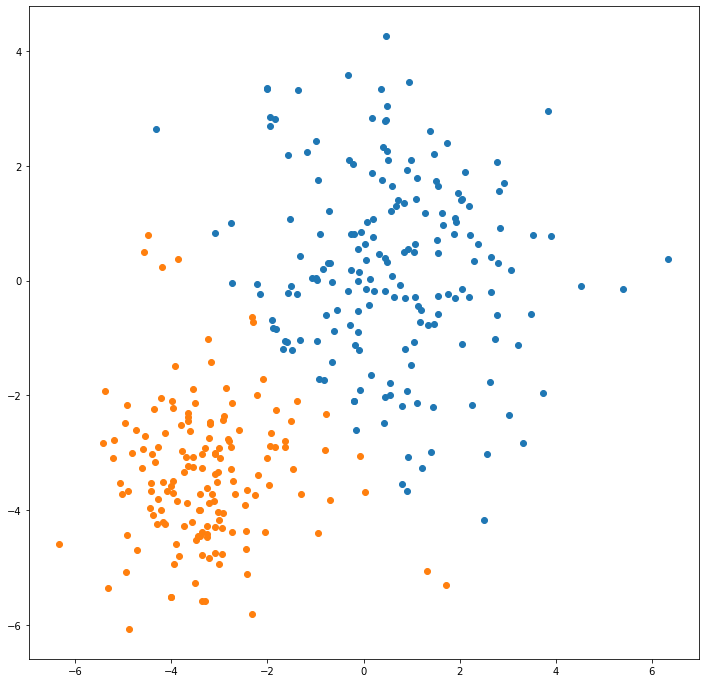

40% від початкових даних:


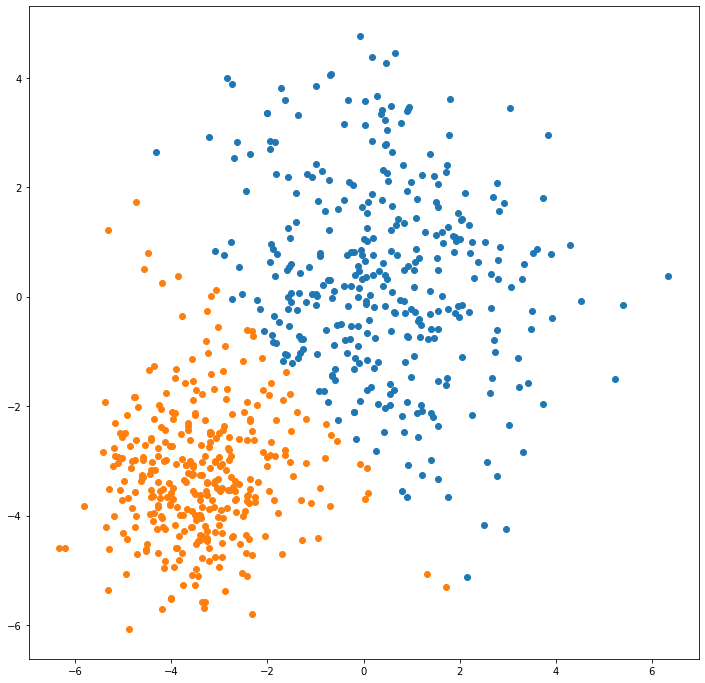

60% від початкових даних:


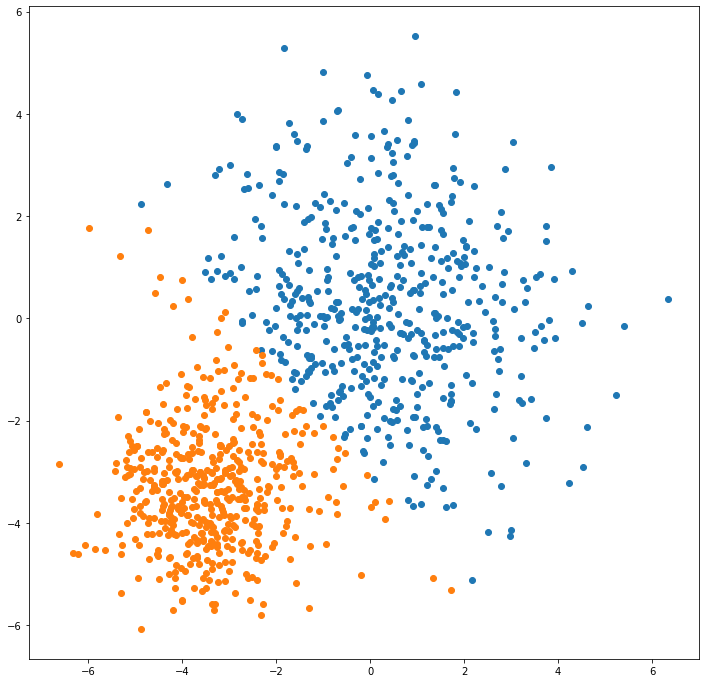

In [19]:
for percentage in percentages:
    cluster_visualisation([model_sub["kmean"][percentage]],subarrays[percentage],
                          labels = [f"{percentage}% від початкових даних:"])  

Тепер порахуємо метрики

In [20]:
print_metrics([KMeans(n_clusters = 2, random_state = 30)], subarrays,
              sub_y = sub_ytrue, labels = ["20%", "40%", "60%"])

                             20%      40%      60%
Adjusted Rand Index :       0.7572   0.6729   0.6942
Calinski-Harabasz Index :   555.5   1044.7   1491.1
Davies-Bouldin index :      0.6609   0.6955   0.7118
fitting time :              0.0457   0.045   0.049


Бачимо наступне:
- Значення метрики Adjusted Rand Index на вибірці 20% є найкращим, а на вибірці 40% - найгіршим
- Значення метрики Calinski-Harabasz Index покращується зі збільшенням розміру вибірки
- Значення метрики Davies-Bouldin index погіршується зі збільшенням розміру вибірки

### 1.7.2 MiniBatchKMeans

Зробимо те ж, що і в попередньому пункті

20% від початкових даних:


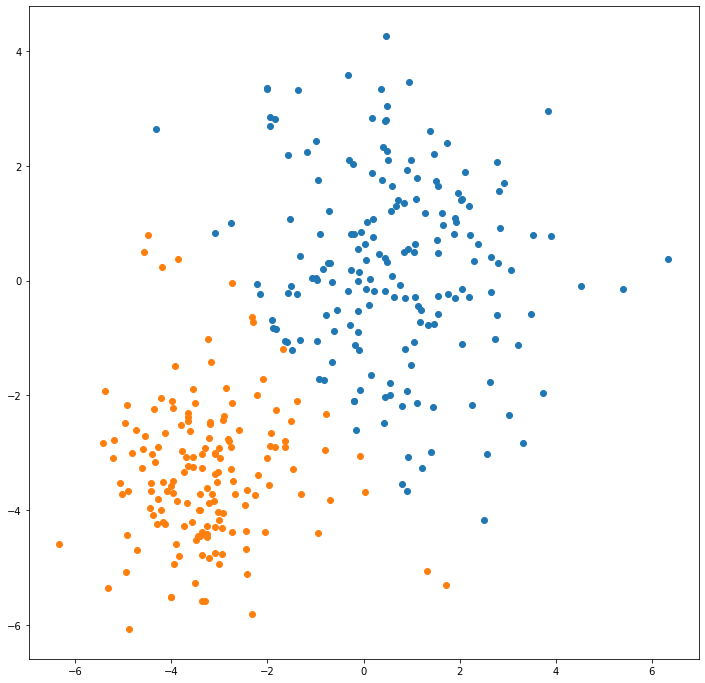

40% від початкових даних:


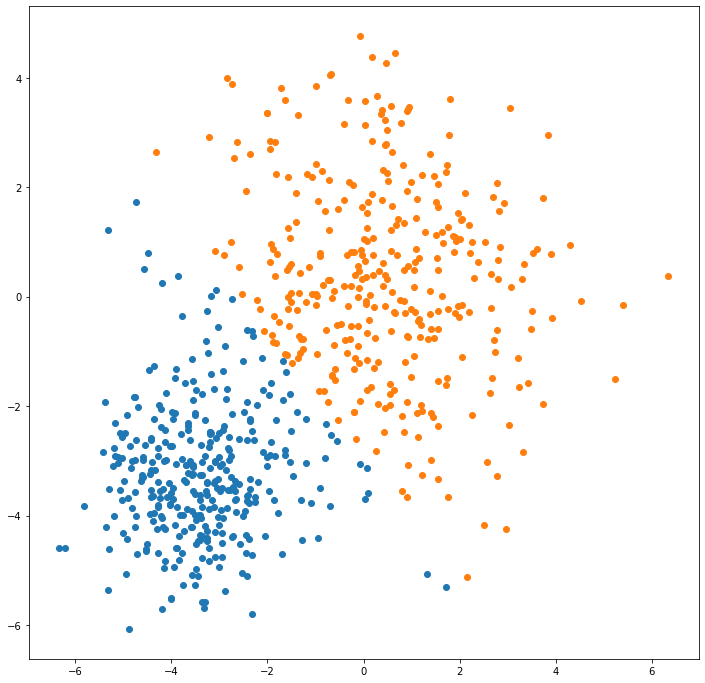

60% від початкових даних:


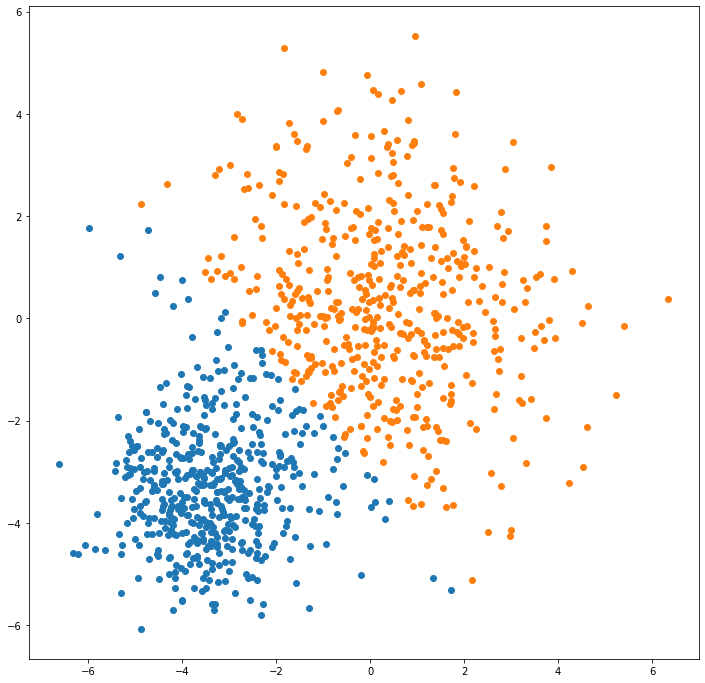

In [21]:
for percentage in percentages:
    cluster_visualisation([model_sub["mini_kmean"][percentage]],subarrays[percentage],
                          labels = [f"{percentage}% від початкових даних:"])  

Тепер порахуємо метрики

In [22]:
print_metrics([MiniBatchKMeans(n_clusters = 2, random_state = 30)], subarrays,
              sub_y = sub_ytrue, labels = ["20%", "40%", "60%"])

                             20%      40%      60%
Adjusted Rand Index :       0.7368   0.6633   0.6811
Calinski-Harabasz Index :   555.4   1044.4   1491.0
Davies-Bouldin index :      0.6637   0.6967   0.7134
fitting time :              0.0462   0.0585   0.072


Як бачимо ситуація така ж як і з метриками для моделі KMeans, тобто:

- Значення метрики Adjusted Rand Index на вибірці 20% є найкращим, а на вибірці 40% - найгіршим
- Значення метрики Calinski-Harabasz Index покращується зі збільшенням розміру вибірки
- Значення метрики Davies-Bouldin index погіршується зі збільшенням розміру вибірки

## 1.8 Підбір кращої моделі

Підберемо кращі параметри для моделей KMeans і MiniBatchKMeans, а потім виберемо з них фінальну.

### 1.8.1 Найкраща модель для KMeans

In [23]:
# будемо шукати найкращі параметри серед:
params = [{"n_clusters":2, "random_state":30},
          {"n_clusters":2, "random_state":30, "init": "random"},
          {"n_clusters":2, "random_state":30, "n_init": 20},
          {"n_clusters":2, "random_state":30, "n_init": 8},
          {"n_clusters":2, "random_state":30, "tol":1e-2},
          {"n_clusters":2, "random_state":30, "tol":1e-3},
          {"n_clusters":2, "random_state":30, "algorithm":"elkan"}
         ]


for param in params:
    print_metrics([KMeans(**param)], X)
    

KMeans(n_clusters=2, random_state=30)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.061


KMeans(init='random', n_clusters=2, random_state=30)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.056


KMeans(n_clusters=2, n_init=20, random_state=30)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.124


KMeans(n_clusters=2, n_init=8, random_state=30)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.053


KMeans(n_clusters=2, random_state=30, tol=0.01)
Adjusted Rand Index:         0.6304
Calinski-Harabasz Index:     2458.2214
Davies-Bouldin index:        0.7198
fitting time:                0.048


KMeans(n_clusters=2, ran

Як бачимо перші три моделі дали найкращі значення метрик, при чому у них вони однакові. Тому виберемо модель з параметрами n_clusters=2, n_init=8, random_state=30, яка найшвидше навчилась.

In [24]:
best_kmean = KMeans(n_clusters=2, n_init=8, random_state=30)

### 1.8.2 Найкраща модель для MiniBatchKMeans

In [25]:
params = [{"n_clusters":2, "random_state":30},
          {"n_clusters":2, "random_state":30, "tol": 1e-2}, 
          {"n_clusters":2, "random_state":30, "tol": 1e-3},
          {"n_clusters":2, "random_state":30, "tol": 1e-4},
          {"n_clusters":2, "random_state":30, "n_init": 6},
          {"n_clusters":2, "random_state":30, "n_init": 10},
          {"n_clusters":2, "random_state":30, "reassignment_ratio": 1e-3},
          {"n_clusters":2, "random_state":30, "reassignment_ratio": 1e-4},
          {"n_clusters":2, "random_state":30, "max_no_improvement": 5},
          {"n_clusters":2, "random_state":30, "max_no_improvement": 15}
           ]

for param in params:
    print_metrics([MiniBatchKMeans(**param)], X)
    

MiniBatchKMeans(n_clusters=2, random_state=30)
Adjusted Rand Index:         0.6455
Calinski-Harabasz Index:     2458.2925
Davies-Bouldin index:        0.7183
fitting time:                0.081


MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.01)
Adjusted Rand Index:         0.6897
Calinski-Harabasz Index:     2446.1198
Davies-Bouldin index:        0.7147
fitting time:                0.017


MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.001)
Adjusted Rand Index:         0.6684
Calinski-Harabasz Index:     2453.7945
Davies-Bouldin index:        0.7164
fitting time:                0.021


MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.0001)
Adjusted Rand Index:         0.6607
Calinski-Harabasz Index:     2456.218
Davies-Bouldin index:        0.7169
fitting time:                0.029


MiniBatchKMeans(n_clusters=2, n_init=6, random_state=30)
Adjusted Rand Index:         0.6267
Calinski-Harabasz Index:     2457.9011
Davies-Bouldin index:        0.7202
fitting time:       

Модель MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.01) має найкращі значення метрик Adjusted Rand Index та Davies-Bouldin index тому виберемо її.

In [26]:
best_minikmean = MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.01)

### 1.8.3 Фінальна модель

In [27]:
best_models = [best_kmean, best_minikmean]
print_metrics(best_models, X)

KMeans(n_clusters=2, n_init=8, random_state=30)
Adjusted Rand Index:         0.6398
Calinski-Harabasz Index:     2458.4859
Davies-Bouldin index:        0.7189
fitting time:                0.048


MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.01)
Adjusted Rand Index:         0.6897
Calinski-Harabasz Index:     2446.1198
Davies-Bouldin index:        0.7147
fitting time:                0.019




Як бачимо, у моделі MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.01) кращі значення метрик Adjusted Rand Index та Davies-Bouldin index, а також вона швидше навчається, тому виберемо її за фінальну. Зобразимо її кластеризацію.

MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.01):


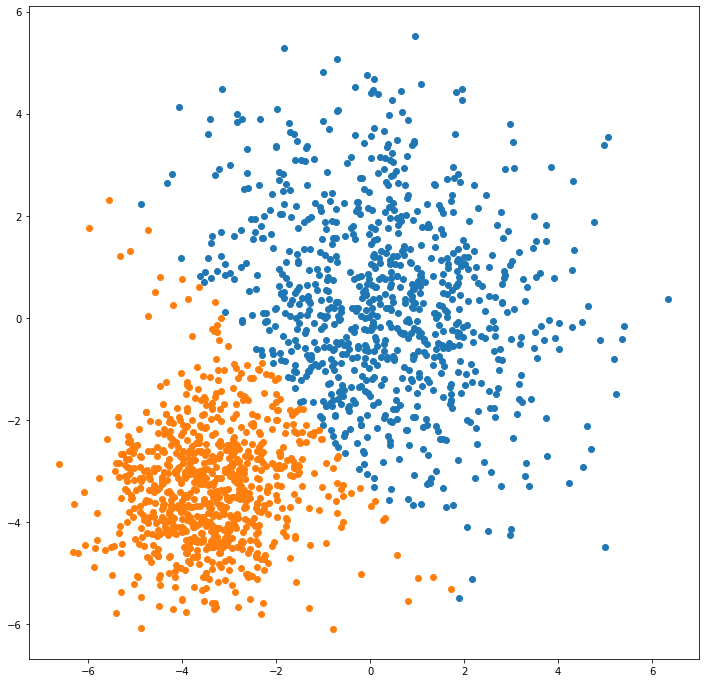

In [28]:
final_model = MiniBatchKMeans(n_clusters=2, random_state=30, tol=0.01)
cluster_visualisation([final_model], X)

## Завдання 2

In [29]:
np.random.seed(0)
n_points_per_cluster = 300000
C1 = [-6, -2] + 0.7 * np.random.randn(n_points_per_cluster, 2)
C2 = [-2 , 2] + 0.3 * np.random.randn(n_points_per_cluster, 2)
C3 = [1, -2]  + 0.2 * np.random.randn(n_points_per_cluster, 2)
C4 = [4, -4]  + 0.1 * np.random.randn(n_points_per_cluster, 2)
C5 = [5, 0]   + 1.4 * np.random.randn(n_points_per_cluster, 2)
C6 = [5 , 6]  + 2.0 * np.random.randn(n_points_per_cluster, 2)
X = np.vstack((C1, C2, C3, C4, C5, C6 ))

clusters = [C2, C1, C3, C4, C5, C6]
y_true = np.zeros(6*300000)
step = 0
cluster_label = 0

for i in range(6):
    y_true[step:300000+step] = np.full((300000,), cluster_label)
    step += 300000 
    cluster_label += 1

## 2.1 Візуалізація

In [ ]:
clusters = [C2, C1, C3, C4, C5, C6]

plt.figure(figsize=(100, 100))
plt.xlim([-10, 10])
plt.ylim([-10, 10])

for cluster in clusters:
    plt.scatter(cluster[:, 0], cluster[:, 1])

## 2.2 Результати кластеризації графічно

In [ ]:
models = [KMeans(n_clusters = 6, random_state = 30),
          MiniBatchKMeans(n_clusters = 6, random_state = 30)
         ]

cluster_visualisation(models, X,
                      second_task = True)

Як бачимо обидва графіки дуже схожі

## 2.3 Час кластеризації

Розрахуємо час кластеризації для таких величин наборів даних:

- n_points_per_cluster = 600000
- n_points_per_cluster = 1000000
- n_points_per_cluster = 1500000

Спочатку порівняємо час кластеризування для моделі KMeans 

In [32]:
# створення кластерів
clusters_size = [600000, 1000000, 1500000]
X_time = {}

for size in clusters_size:
    C1_ = [-6, -2] + 0.7 * np.random.randn(size, 2)
    C2_ = [-2 , 2] + 0.3 * np.random.randn(size, 2)
    C3_ = [1, -2]  + 0.2 * np.random.randn(size, 2)
    C4_ = [4, -4]  + 0.1 * np.random.randn(size, 2)
    C5_ = [5, 0]   + 1.4 * np.random.randn(size, 2)
    C6_ = [5 , 6]  + 2.0 * np.random.randn(size, 2)
    X_time[size] = np.vstack((C1_, C2_, C3_, C4_, C5_, C6_))

In [33]:
time_calculation(KMeans(n_clusters = 6, random_state = 30), X_time)

600000              7.11323
1000000             13.40607
1500000             19.46658


Тепер порівняємо час кластеризування для моделі MiniBatchKMeans

In [34]:
time_calculation(MiniBatchKMeans(n_clusters = 6, random_state = 30), X_time)

600000              7.48606
1000000             12.26697
1500000             18.74681


Як бачимо модель MiniBatchKMeans навчається швидше на наборах даних, де n_points_per_cluster дорівнює 1000000 і 1500000

## 2.4 Альтернативні моделі для KMeans

Побудуємо такі альтернативні моделі:

- KMeans(n_clusters = 2, random_state = 30)
- KMeans(n_clusters = 2, random_state = 42, algorithm = "elkan")
- KMeans(n_clusters = 2, random_state = 42, tol = 1e-3)
- KMeans(n_clusters = 4, random_state = 42)

In [ ]:
kmean_models = [KMeans(n_clusters = 6, random_state = 30),
                KMeans(n_clusters = 6, random_state = 42, algorithm = "elkan"),
                KMeans(n_clusters = 6, random_state = 42, tol = 1e-3),
                KMeans(n_clusters = 20, random_state = 42)
]

cluster_visualisation(kmean_models, X, second_task = True)

Тепер порахуємо метрики

In [36]:
print_metrics(kmean_models, X, y_true = y_true)

KMeans(n_clusters=6, random_state=30)
Adjusted Rand Index:         0.9003
Calinski-Harabasz Index:     5239941.3128
Davies-Bouldin index:        0.462
fitting time:                15.7805


KMeans(algorithm='elkan', n_clusters=6, random_state=42)
Adjusted Rand Index:         0.9003
Calinski-Harabasz Index:     5239938.8599
Davies-Bouldin index:        0.4621
fitting time:                17.069


KMeans(n_clusters=6, random_state=42, tol=0.001)
Adjusted Rand Index:         0.9002
Calinski-Harabasz Index:     5239934.959
Davies-Bouldin index:        0.462
fitting time:                11.4526


KMeans(n_clusters=20, random_state=42)
Adjusted Rand Index:         0.7074
Calinski-Harabasz Index:     5544624.8367
Davies-Bouldin index:        0.7769
fitting time:                113.8897




Бачимо наступне:

- Остання модель дає найкраще значення метрики Calinski-Harabasz Index, але при цьому у неї набагато гірше значення інших метрик, а також найбільший час навчання.
- У моделі KMeans(n_clusters=6, random_state=30) найкращі значення метрик Adjusted Rand Index та Davies-Bouldin index

## 2.5 Альтернативні моделі для MiniBatchKMeans

Побудуємо такі альтернативні моделі:
- MiniBatchKMeans(n_clusters = 6, random_state = 30)
- MiniBatchKMeans(n_clusters = 6, random_state = 42)
- MiniBatchKMeans(n_clusters = 6, random_state = 30, reassignment_ratio = 0.01)
- MiniBatchKMeans(n_clusters = 10, random_state = 42, n_init = 5)

MiniBatchKMeans(n_clusters=6, random_state=42):


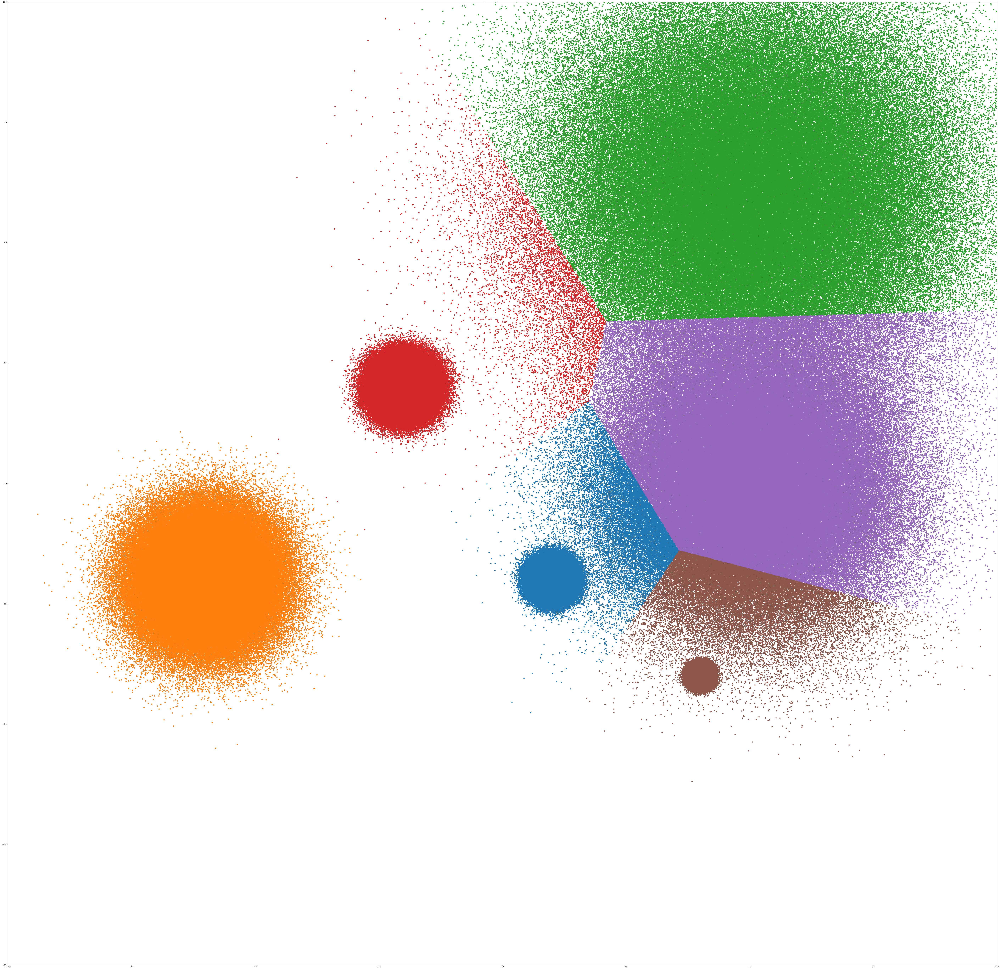

MiniBatchKMeans(n_clusters=6, random_state=30):


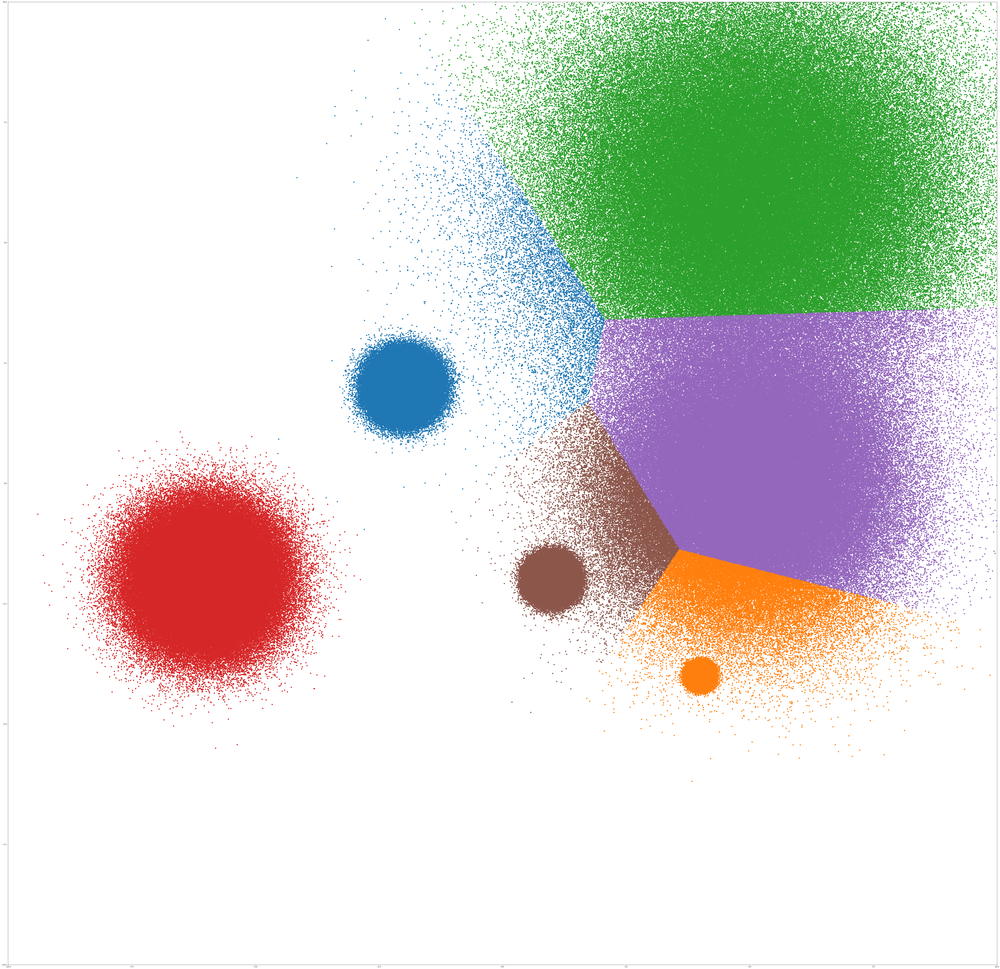

MiniBatchKMeans(n_clusters=6, n_init=5, random_state=42):


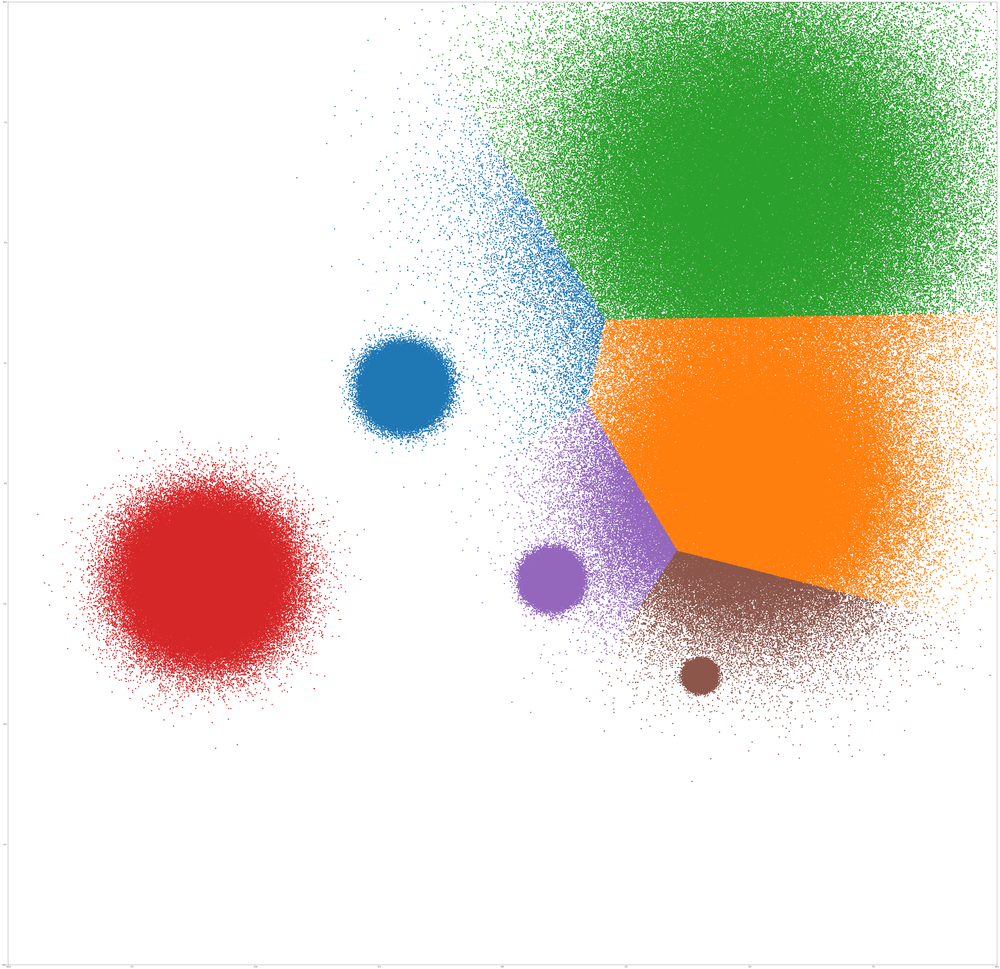

MiniBatchKMeans(n_clusters=10, random_state=30):


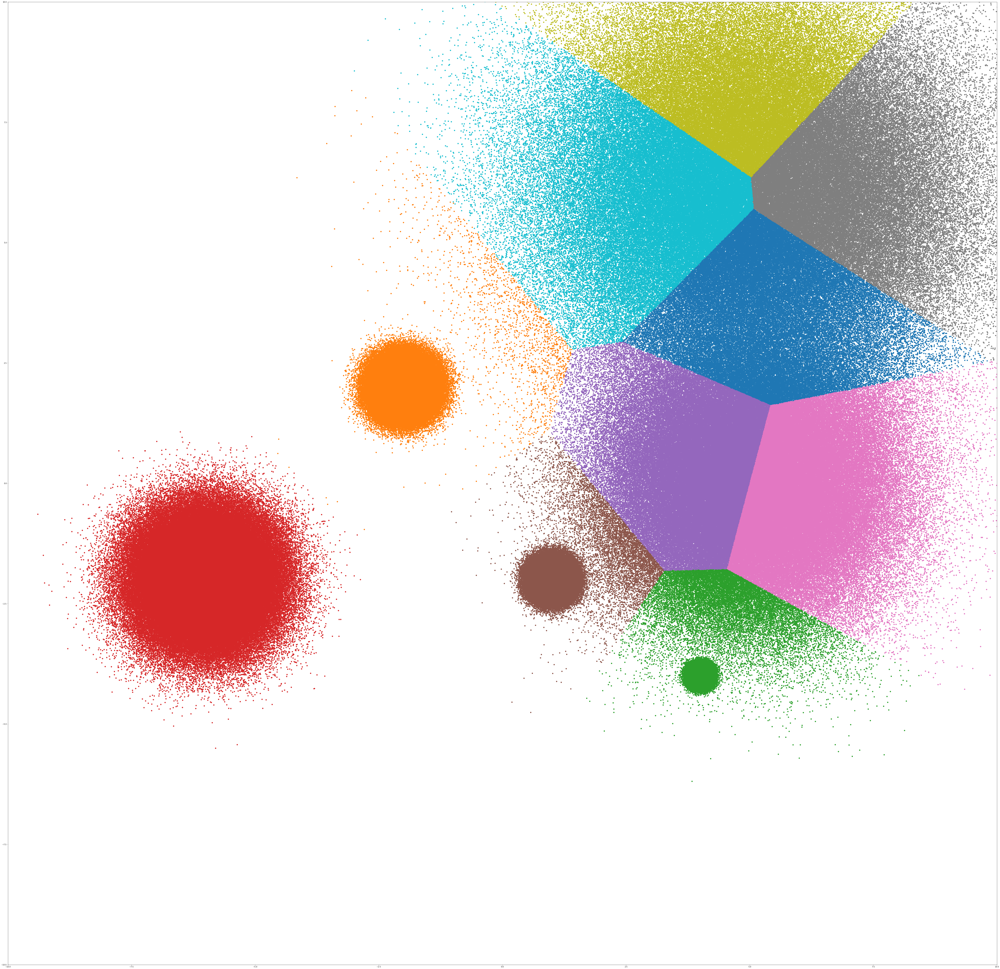

In [37]:
minikmean_models = [MiniBatchKMeans(n_clusters = 6, random_state = 42),
                    MiniBatchKMeans(n_clusters = 6, random_state = 30, reassignment_ratio = 0.01),
                    MiniBatchKMeans(n_clusters = 6, random_state = 42, n_init = 5),
                    MiniBatchKMeans(n_clusters = 10, random_state = 30)
                   ]

#cluster_visualisation(minikmean_models, X, second_task = True)

Тепер порахуємо метрики

In [38]:
print_metrics(minikmean_models, X, y_true = y_true)

MiniBatchKMeans(n_clusters=6, random_state=42)
Adjusted Rand Index:         0.9001
Calinski-Harabasz Index:     5239829.5279
Davies-Bouldin index:        0.4618
fitting time:                0.132


MiniBatchKMeans(n_clusters=6, random_state=30)
Adjusted Rand Index:         0.8976
Calinski-Harabasz Index:     5239273.7221
Davies-Bouldin index:        0.4627
fitting time:                0.29


MiniBatchKMeans(n_clusters=6, n_init=5, random_state=42)
Adjusted Rand Index:         0.9011
Calinski-Harabasz Index:     5239828.1421
Davies-Bouldin index:        0.4619
fitting time:                0.179


MiniBatchKMeans(n_clusters=10, random_state=30)
Adjusted Rand Index:         0.8225
Calinski-Harabasz Index:     5803302.3076
Davies-Bouldin index:        0.7059
fitting time:                2.0329




З останньою моделлю ситуація така ж, як і в попередьому пункті. Серед перших трьох моделей у першої моделі найкраще значення метрики Davies-Bouldin index, в третьої - Adjusted Rand Index

## 2.6 Перевірка результатів кластеризації одним з неформальних способів

Зробимо так же, як і в відповідному пункті попереднього завдання, тобто перемішаємо дані, а потім виділимо підвибірки таких розмірів: 20%, 40%, 60%  і перевіримо якість кластеризації графічно, а також за допомогою метрик

In [ ]:
data = np.concatenate((X, y_true[:, np.newaxis]), axis = 1)
shuffle(data)

X_shuffled = data[:, :2]
y_shuffled = data[:,  2]

#перевіримо чи не змінилась візуалізція даних
plt.figure(figsize=(100, 100))
plt.scatter(X_shuffled[:, 0], X_shuffled[:, 1]);

In [40]:
# створимо підбірки даних
percentages = [0.2, 0.4, 0.6]
subarrays = {}
sub_ytrue = {}

for percentage in percentages:
    
    subarr_len = int(len(X)*percentage)
    subarrays[int(percentage*100)] = X_shuffled[:subarr_len]
    sub_ytrue[int(percentage*100)] = y_shuffled[:subarr_len]
    
    # перевірка коректонсті розбиття
    print(f"{percentage *100}% -> {len(subarrays[percentage*100])}")


20.0% -> 360000
40.0% -> 720000
60.0% -> 1080000


In [41]:
# тепер навчимо моделі 
model_sub = {"kmean": {}, "mini_kmean":{}}
percentages = list(subarrays.keys())

for percentage in percentages:
    
    model_sub["kmean"][percentage] = KMeans(n_clusters = 6, random_state = 30).fit(subarrays[percentage])
    model_sub["mini_kmean"][percentage] = MiniBatchKMeans(n_clusters = 6, random_state = 30).fit(subarrays[percentage])
        
    

### 2.6.1 KMeans

In [ ]:
for percentage in percentages:
    cluster_visualisation([model_sub["kmean"][percentage]],subarrays[percentage],
                          labels = [f"{percentage}% від початкових даних:"], second_task = True)  

Тепер виведемо значення метрик

In [43]:
print_metrics([KMeans(n_clusters = 6, random_state = 30)], subarrays,
              sub_y = sub_ytrue, labels = ["20%", "40%", "60%"])

                             20%      40%      60%
Adjusted Rand Index :       0.9009   0.9007   0.901
Calinski-Harabasz Index :   1049474.1   2099422.9   3143283.0
Davies-Bouldin index :      0.4613   0.4612   0.4617
fitting time :              5.422   6.3407   8.2102


Бачимо наступне:

- На вибірці розміру 60% досягається найкраще значення метрики Adjusted Rand Index, а на вибірці розміру 40% - найгріше
- Зі збільшенням розбіру вибірки покращується значення метрики Calinski-Harabasz Index 
- Найраще значення метрики Davies-Bouldin index досягається на вибірці розміру 40%, а найгірше на вибірці розміру 60%

### 2.6.2 MiniBatchKMeans

In [ ]:
for percentage in percentages:
    cluster_visualisation([model_sub["mini_kmean"][percentage]],subarrays[percentage],
                          labels = [f"{percentage}% від початкових даних:"], second_task = True)  

Тепер порахуємо метрики

In [45]:
print_metrics([MiniBatchKMeans(n_clusters = 6, random_state = 30)], subarrays,
              sub_y = sub_ytrue, labels = ["20%", "40%", "60%"])

                             20%      40%      60%
Adjusted Rand Index :       0.901   0.9032   0.8936
Calinski-Harabasz Index :   1049419.7   2099179.0   3141172.7
Davies-Bouldin index :      0.461   0.4605   0.4637
fitting time :              0.451   0.5654   0.108


- На вибірці розміру 40% досягається найкраще значення метрики Adjusted Rand Index, а на вибірці розміру 60% - найгріше
- Зі збільшенням розбіру вибірки покращується значення метрики Calinski-Harabasz Index 
- Найраще значення метрики Davies-Bouldin index досягається на вибірці розміру 40%, а найгірше на вибірці розміру 60%

## 2.7 Підбір кращої моделі
Підберемо кращі параметри для моделей KMeans і MiniBatchKMeans, а потім виберемо з них фінальну.

### 2.8.1 Найкраща модель для KMeans

In [46]:
# будемо шукати найкращі параметри серед:
params = [{"n_clusters":6, "random_state":30},
          {"n_clusters":6, "random_state":30, "init": "random"},
          {"n_clusters":6, "random_state":30, "n_init": 20},
          {"n_clusters":6, "random_state":30, "n_init": 8},
          {"n_clusters":6, "random_state":30, "tol":1e-2},
          {"n_clusters":6, "random_state":30, "tol":1e-3},
          {"n_clusters":6, "random_state":30, "algorithm":"elkan"}
         ]

for param in params:
    print_metrics([KMeans(**param)], X, y_true = y_true)

KMeans(n_clusters=6, random_state=30)
Adjusted Rand Index:         0.9003
Calinski-Harabasz Index:     5239941.3128
Davies-Bouldin index:        0.462
fitting time:                14.2494


KMeans(init='random', n_clusters=6, random_state=30)
Adjusted Rand Index:         0.9004
Calinski-Harabasz Index:     5239949.6081
Davies-Bouldin index:        0.462
fitting time:                14.7768


KMeans(n_clusters=6, n_init=20, random_state=30)
Adjusted Rand Index:         0.9004
Calinski-Harabasz Index:     5239949.5757
Davies-Bouldin index:        0.462
fitting time:                31.4657


KMeans(n_clusters=6, n_init=8, random_state=30)
Adjusted Rand Index:         0.9003
Calinski-Harabasz Index:     5239941.3128
Davies-Bouldin index:        0.462
fitting time:                14.7757


KMeans(n_clusters=6, random_state=30, tol=0.01)
Adjusted Rand Index:         0.899
Calinski-Harabasz Index:     5239629.9391
Davies-Bouldin index:        0.4625
fitting time:                8.9381


KMean

Як бачимо друга та третя моделі дають найкращі значення метрик Adjusted Rand Index та Davies-Bouldin index, тому виберемо серед них. У другої моделі краще значення метрики Calinski-Harabasz Index, тому виберемо її

In [47]:
best_kmean = KMeans(init='random', n_clusters=6, random_state=30)

### 2.8.2 Найкраща модель для MiniBatchKMeans

In [48]:
params = [{"n_clusters":6, "random_state":30},
          {"n_clusters":6, "random_state":30, "tol": 1e-2}, 
          {"n_clusters":6, "random_state":30, "tol": 1e-3},
          {"n_clusters":6, "random_state":30, "tol": 1e-4},
          {"n_clusters":6, "random_state":30, "n_init": 6},
          {"n_clusters":6, "random_state":30, "n_init": 10},
          {"n_clusters":6, "random_state":30, "reassignment_ratio": 1e-3},
          {"n_clusters":6, "random_state":30, "reassignment_ratio": 1e-4},
          {"n_clusters":6, "random_state":30, "max_no_improvement": 5},
          {"n_clusters":6, "random_state":30, "max_no_improvement": 15}
           ]

for param in params:
    print_metrics([MiniBatchKMeans(**param)], X, y_true = y_true)
    

MiniBatchKMeans(n_clusters=6, random_state=30)
Adjusted Rand Index:         0.8976
Calinski-Harabasz Index:     5239273.7221
Davies-Bouldin index:        0.4627
fitting time:                0.345


MiniBatchKMeans(n_clusters=6, random_state=30, tol=0.01)
Adjusted Rand Index:         0.8786
Calinski-Harabasz Index:     5208030.8234
Davies-Bouldin index:        0.4688
fitting time:                0.164


MiniBatchKMeans(n_clusters=6, random_state=30, tol=0.001)
Adjusted Rand Index:         0.8844
Calinski-Harabasz Index:     5222164.7983
Davies-Bouldin index:        0.4664
fitting time:                0.1713


MiniBatchKMeans(n_clusters=6, random_state=30, tol=0.0001)
Adjusted Rand Index:         0.8893
Calinski-Harabasz Index:     5231530.143
Davies-Bouldin index:        0.465
fitting time:                0.179


MiniBatchKMeans(n_clusters=6, n_init=6, random_state=30)
Adjusted Rand Index:         0.8977
Calinski-Harabasz Index:     5239238.9708
Davies-Bouldin index:        0.4628
fitti

У шостої моделі найкращі значення метрик Adjusted Rand Index та Davies-Bouldin index, тому виберемо її за фінальну.

In [49]:
best_minikmean = MiniBatchKMeans(n_clusters=6, n_init=10, random_state=30)

### 2.8.3 Фінальна модель

In [50]:
best_models = [best_kmean, best_minikmean]
print_metrics(best_models, X, y_true = y_true)

KMeans(init='random', n_clusters=6, random_state=30)
Adjusted Rand Index:         0.9004
Calinski-Harabasz Index:     5239949.6081
Davies-Bouldin index:        0.462
fitting time:                16.5362


MiniBatchKMeans(n_clusters=6, n_init=10, random_state=30)
Adjusted Rand Index:         0.898
Calinski-Harabasz Index:     5239354.8892
Davies-Bouldin index:        0.4627
fitting time:                0.3155




У моделі KMeans кращі значення всих метрик, тому виберемо її за фінальну. Зобразимо її кластеризацію

In [ ]:
final_model = KMeans(n_clusters=6, n_init=20, random_state=30)
cluster_visualisation([final_model], X, second_task = True)

**Висновок**. У ході даної лобораторної роботи я навчився кластеризувати дані, а також оцінювати якість кластеризації за допопмогою бібліотеки scikit-learn